In [1]:
import pandas as pd
import numpy as np
import networkx as nx
import matplotlib.pyplot as plt

# 读入

# 转换

In [ ]:
Bus_Stops['Routes_Ser'] = Bus_Stops['Routes_Ser'].apply(lambda row: len(row.split(',')) if isinstance(row, str) else 0)


In [20]:
Bus_Stops['Routes_Ser'] = Bus_Stops['Routes_Ser'].apply(lambda row: len(row.split(',')) if isinstance(row, str) else 0)
edges_all["lanes"] = pd.to_numeric(edges_all["lanes"], errors="coerce")
edges_all["maxspeed"] = edges_all["maxspeed"].apply(
    lambda x: x.replace("mph", "").strip() if isinstance(x, str) else x
)
# 如果 'maxspeed' 列包含像 ['45 ', '60 '] 这样的列表，取出第一个值
edges_all["maxspeed"] = edges_all["maxspeed"].apply(
    lambda x: eval(x)[0] if isinstance(x, str) and x.startswith("[") else x
)
edges_all["maxspeed"] = pd.to_numeric(edges_all["maxspeed"], errors="coerce")
edges_all["lanes"].fillna(edges_all["lanes"].median(), inplace=True)
edges_all["maxspeed"].fillna(edges_all["maxspeed"].median(), inplace=True)

pos=dict()
for _,row in nodes_all.iterrows():
    pos[row['osmid']]=(row['x'],row['y'])

C:\Users\simba\AppData\Local\Temp\ipykernel_40048\1801522482.py:11: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  edges_all["lanes"].fillna(edges_all["lanes"].median(), inplace=True)
C:\Users\simba\AppData\Local\Temp\ipykernel_40048\1801522482.py:12: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behav

In [4]:
alpha, beta, gamma = 0.5, 0.4, 0.5

def calculate_weight(row):
    length_weight = row["length"] / max_length
    aadt_weight = 0
    #aadt_weight = row["AADT 2022"] / max_aadt
    lanes_weight = row["lanes"] / max_lanes
    return alpha * length_weight + beta * aadt_weight + gamma * lanes_weight

max_length = edges_all["length"].max()
#max_aadt = edges_all["AADT 2022"].max()
max_lanes = edges_all["lanes"].max()
for _, row in edges_all.iterrows():
    edges_all.loc[_, "weight"] = calculate_weight(row)

In [5]:
G = nx.DiGraph()
cnt=0
for _, row in edges_all.iterrows():
    if row["u"] == row["v"]:
        continue
    cnt+=1
    #if cnt>10000:
        #break
    G.add_edge(
        row["u"],
        row["v"],
        weight=row["weight"],
        length=row["length"],
        lanes=row["lanes"],
        maxspeed=row["maxspeed"],
    )

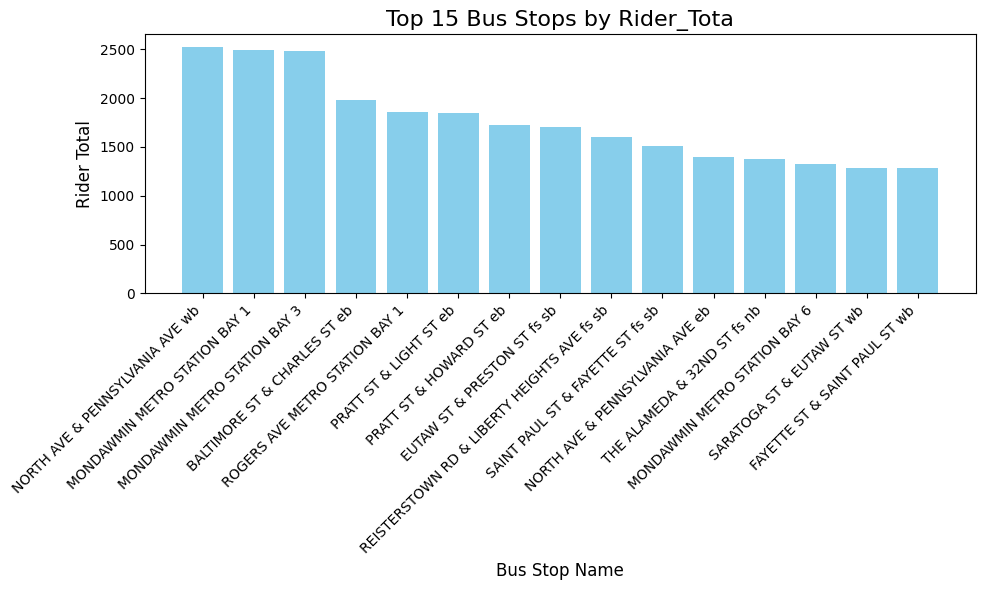

In [6]:
import matplotlib.pyplot as plt

top_15_riders = Bus_Stops[['stop_name', 'Rider_Tota']].sort_values(by='Rider_Tota', ascending=False).head(15)

plt.figure(figsize=(10, 6))
plt.bar(top_15_riders['stop_name'], top_15_riders['Rider_Tota'], color='skyblue')

plt.title('Top 15 Bus Stops by Rider_Tota', fontsize=16)
plt.xlabel('Bus Stop Name', fontsize=12)
plt.ylabel('Rider Total', fontsize=12)
plt.xticks(rotation=45, ha='right') 

plt.tight_layout()  
plt.show()

In [8]:
plt.figure(figsize=(100,100))

print("Drawing nodes")
nx.draw_networkx_nodes(G,pos,node_size=1,node_color='blue',alpha=0.3)

print("Drawing edges")
nx.draw_networkx_edges(G,pos,edge_color='gray',width=3,style='dashed')

print("Drawing high weight edges")
#high_weight_edges = [(u, v) for u, v, d in G.edges(data=True) if d['weight'] > 0.15]
#nx.draw_networkx_edges(G,pos,edgelist=high_weight_edges,edge_color='red',width=5,style='solid') 

plt.scatter(Bus_Stops['stop_name'], Bus_Stops['Rider_Tota'], color='lightgray')


plt.title('Traffic Network of Baltimore with Bus Stops', fontsize=16)
plt.figure(figsize=(20, 20))

plt.scatter(Bus_Stops['stop_name'], Bus_Stops['Rider_Tota'], color='lightgray')

plt.scatter(top_15_riders['stop_name'], top_15_riders['Rider_Tota'], color='red')
plt.axis('off')
plt.tight_layout()
plt.savefig('./images/traffic_network_baltimore.svg', format='svg')
plt.show()


Drawing nodes
Drawing edges
Drawing high weight edges


In [ ]:
import seaborn as sns

plt.figure(figsize=(10, 8))